# Домашнее задание 5
Домашнее задание основано на соревновании
https://www.kaggle.com/competitions/jigsaw-toxic-comment-classiﬁcation-challenge/data
Цель: обучить текстовый классификатор простых фичах с помощью Spark ML  
1) HashingTF и IDF - 70 баллов  
2) Word2Vec - 30 баллов  
ДЗ предлагается сделать в ноутбуке и в формате ipynb загрузить в репозиторий на Github и прислать ссылку на него в интерфейсе сдачи

In [1]:
import os
import time
import numpy as np
import pandas as pd

import pyspark
import pyspark.sql.functions as f
from pyspark.ml import feature
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.evaluation import BinaryClassificationEvaluator
from pyspark.mllib.evaluation import BinaryClassificationMetrics

import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rc
sns.set_style("whitegrid")
sns.set_palette("colorblind")
sns.set(
    rc={
        'figure.figsize': (12, 8),
    }
)

# Блок 1. HashingTF и IDF
1) Подготовить фичи комментариев с помощью HashingTF и IDF  
2) Обучить линейные классификаторы и сравнить метрики качества моделей  
3) Сделать выводы о влиянии параметра numFeatures в HashingTF на качество метрик  

In [2]:
os.environ["PYSPARK_SUBMIT_ARGS"] = "--master local[2] pyspark-shell"

In [3]:
#pd.set_option('display.max_colwidth', -1)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

app_name = 'HW5'
queue = 'default'

#SUBMIT_ARGS = "--jars tfidf.jar"
#os.environ["PYSPARK_SUBMIT_ARGS"] = SUBMIT_ARGS

sps = pyspark.sql.SparkSession \
    .builder \
    .appName(app_name) \
    .master("local[*]") \
    .config("spark.executor.memory", "50G") \
    .config("spark.driver.memory", "50G") \
    .config('spark.driver.maxResultSize', '20G') \
    .config("spark.memory.offHeap.enabled",True) \
    .config("spark.memory.offHeap.size","16g") \
    .getOrCreate()

sc = sps.sparkContext
spark = sps

/home/alex/anaconda3/envs/tf-gpu/lib/python3.6/site-packages/pyspark/context.py:238: FutureWarning: Python 3.6 support is deprecated in Spark 3.2.
  FutureWarning


In [4]:
source_df = spark.read \
    .option("header",True) \
    .option("quote", "\"") \
    .option("escape", "\"") \
    .option("multiline", True) \
    .csv("./data/train.csv")

source_df.printSchema()

root
 |--                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               

In [5]:
test_df = spark.read \
    .option("header",True) \
    .option("quote", "\"") \
    .option("escape", "\"") \
    .option("multiline", True) \
    .csv("./data/test.csv") \
    .withColumn("lower_text", f.lower(f.col("comment_text")))

In [ ]:
source_pd_df = source_df.limit(10).toPandas()
source_pd_df.head()

In [7]:
lowered_df = source_df \
    .withColumn("lower_text", f.lower(f.col("comment_text")))

In [8]:
# pipeline
tokenizing_stage = feature.Tokenizer(inputCol="lower_text", outputCol="tokenized_words")
word_filterring_stage = feature.StopWordsRemover(inputCol="tokenized_words", outputCol="filtered_words")
tf_stage = feature.HashingTF(inputCol="filtered_words", outputCol="raw_features", numFeatures=20)
idf_stage = feature.IDF(inputCol="raw_features", outputCol="features")
indexing_stage = feature.StringIndexer(inputCol = "toxic", outputCol = "label")
lr_stage = LogisticRegression(maxIter=10)
    
preparing_pipeline = pyspark.ml.Pipeline(stages= [
    tokenizing_stage,
    word_filterring_stage,
    tf_stage,
    idf_stage,
    indexing_stage,
    lr_stage
])

model = preparing_pipeline.fit(lowered_df)
prepared_df = model.transform(lowered_df)

In [ ]:
prepared_pd_df = prepared_df.limit(10).toPandas()
prepared_pd_df.head()

In [8]:
def auto_barlabel(ax, rects, values):
    for rect, value in (rects, values):
        height = rect.get_height()
        ax.text(
            rect.get_x() + rect.get_width() / 2.,
            1.05 * height,
            "{:10.4f}".format(height),
            ha='center',
            va='bottom'
    )

def set_barlabel(ax, rects, values):
    for rect, value in zip(rects, values):
        height = rect.get_height()
        ax.text(
            rect.get_x() + rect.get_width() / 2.,
            1.05 * height,
            "{:10.4f}".format(value),
            ha='center',
            va='bottom'
    )


In [9]:
def create_pipeline(target_col="toxic"):
    tokenizing_stage = feature.Tokenizer(inputCol="lower_text", outputCol="tokenized_words")
    word_filterring_stage = feature.StopWordsRemover(inputCol="tokenized_words", outputCol="filtered_words")
    tf_stage = feature.HashingTF(inputCol="filtered_words", outputCol="raw_features", numFeatures=20)
    idf_stage = feature.IDF(inputCol="raw_features", outputCol="features")
    indexing_stage = feature.StringIndexer(inputCol=target_col, outputCol="label")
    lr_stage = LogisticRegression(maxIter=10)

    preparing_pipeline = pyspark.ml.Pipeline(stages= [
        tokenizing_stage,
        word_filterring_stage,
        tf_stage,
        idf_stage,
        indexing_stage,
        lr_stage
    ])

def print_results(model, title=None):
    avg_metrics = model.avgMetrics    
    param_names = [
        "{}: {}".format(param.name, value) 
        for param_dict in model.getEstimatorParamMaps()
        for param, value in param_dict.items()
    ]

    fig, ax = plt.subplots()
    bars = ax.bar(param_names, avg_metrics)

    if title:
        ax.set_title(title)
    set_barlabel(ax, bars, avg_metrics)
    plt.xticks(rotation=60)
    plt.show()
    
    max_idx = np.argmax(avg_metrics)
    print("Most efficient {}: {:5.4f}".format(param_names[max_idx], avg_metrics[max_idx]))

In [10]:
def get_scores(model):
    avg_metrics = model.avgMetrics    
    param_names = [
        "{}: {}".format(param.name, value) 
        for param_dict in model.getEstimatorParamMaps()
        for param, value in param_dict.items()
    ] 
    return dict(zip(param_names, avg_metrics))

In [11]:
results = {}
num_features_grid = [5, 10, 20, 50, 100, 200, 500, 1000, 1500, 2000, 5000]

In [12]:
def tfidf_fit_cv(target_col="toxic", df=lowered_df, num_features_grid=num_features_grid):
    
    tokenizing_stage = feature.Tokenizer(inputCol="lower_text", outputCol="tokenized_words")
    word_filterring_stage = feature.StopWordsRemover(inputCol="tokenized_words", outputCol="filtered_words")
    tf_stage = feature.HashingTF(inputCol="filtered_words", outputCol="raw_features", numFeatures=20)
    idf_stage = feature.IDF(inputCol="raw_features", outputCol="features")
    indexing_stage = feature.StringIndexer(inputCol=target_col, outputCol="label")
    lr_stage = LogisticRegression(maxIter=10)

    preparing_pipeline = pyspark.ml.Pipeline(stages= [
        tokenizing_stage,
        word_filterring_stage,
        tf_stage,
        idf_stage,
        indexing_stage,
        lr_stage
    ])

    param_grid = ParamGridBuilder().addGrid(
        tf_stage.numFeatures, 
        num_features_grid
    ).build()

    cv = CrossValidator(
        estimator=preparing_pipeline,
        estimatorParamMaps=param_grid, 
        evaluator=BinaryClassificationEvaluator(),
        #verbose=10,
        seed=7776
    )
    model = cv.fit(df)
  
    return model

Exception ignored in: <object repr() failed>
Traceback (most recent call last):
  File "/home/alex/anaconda3/envs/tf-gpu/lib/python3.6/site-packages/pyspark/ml/wrapper.py", line 39, in __del__
    if SparkContext._active_spark_context and self._java_obj is not None:
AttributeError: 'BinaryClassificationEvaluator' object has no attribute '_java_obj'
Exception ignored in: <bound method JavaModelWrapper.__del__ of <pyspark.mllib.evaluation.BinaryClassificationMetrics object at 0x7fccb8843898>>
Traceback (most recent call last):
  File "/home/alex/anaconda3/envs/tf-gpu/lib/python3.6/site-packages/pyspark/mllib/common.py", line 137, in __del__
    self._sc._gateway.detach(self._java_model)
AttributeError: 'BinaryClassificationMetrics' object has no attribute '_sc'
Exception ignored in: <object repr() failed>
Traceback (most recent call last):
  File "/home/alex/anaconda3/envs/tf-gpu/lib/python3.6/site-packages/pyspark/ml/wrapper.py", line 39, in __del__
    if SparkContext._active_spark_con

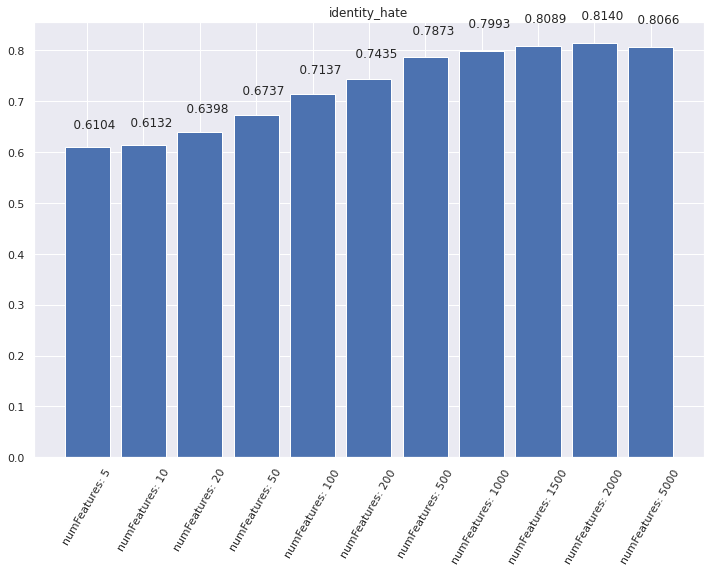

Most efficient numFeatures: 2000: 0.8140
Fitting identity_hate model spent   529.7970


{'identity_hate_model': {'numFeatures: 5': 0.6103958587169676,
  'numFeatures: 10': 0.6132399066663685,
  'numFeatures: 20': 0.6397861735984552,
  'numFeatures: 50': 0.6737453848624141,
  'numFeatures: 100': 0.713650541182604,
  'numFeatures: 200': 0.7435314226838603,
  'numFeatures: 500': 0.7872704780227064,
  'numFeatures: 1000': 0.7992965679655386,
  'numFeatures: 1500': 0.80885877960294,
  'numFeatures: 2000': 0.814047659971889,
  'numFeatures: 5000': 0.8066324575560444}}

In [39]:
eval_time = time.time()
identity_hate_model = tfidf_fit_cv("identity_hate")
eval_time = time.time() - eval_time

print_results(identity_hate_model, "identity_hate")
results["identity_hate_model"] = get_scores(identity_hate_model)
print("Fitting identity_hate model spent {:10.4f}".format(eval_time))
results

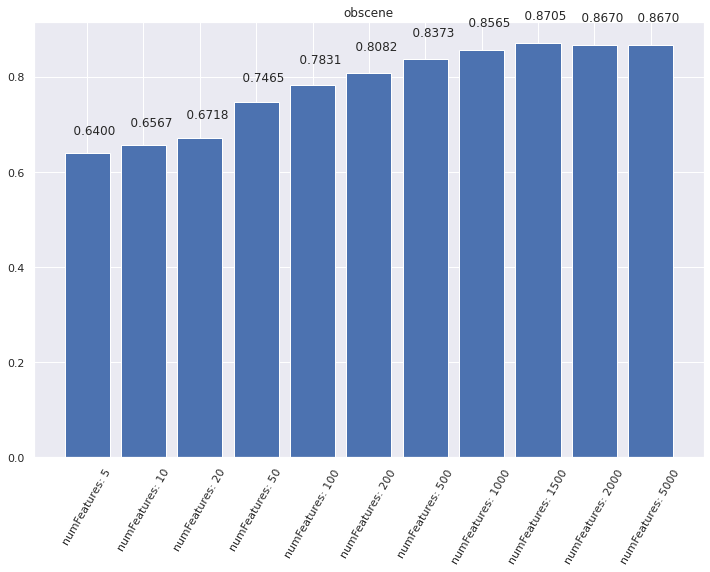

Most efficient numFeatures: 1500: 0.8705
Fitting obscene model spent   575.3753


In [18]:
eval_time = time.time()
obscene_model = tfidf_fit_cv("obscene")
eval_time = time.time() - eval_time

print_results(obscene_model, "obscene")
results["obscene_model"] = get_scores(obscene_model)
print("Fitting obscene model spent {:10.4f}".format(eval_time))

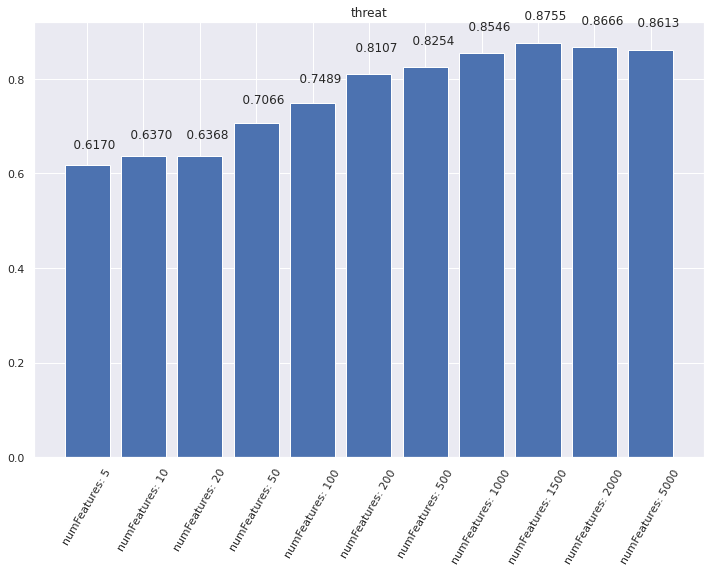

Most efficient numFeatures: 1500: 0.8755
Fitting threat model spent   562.2667


In [20]:
eval_time = time.time()
threat_model = tfidf_fit_cv("threat")
eval_time = time.time() - eval_time

print_results(threat_model, "threat")
results["threat_model"] = get_scores(threat_model)
print("Fitting threat model spent {:10.4f}".format(eval_time))

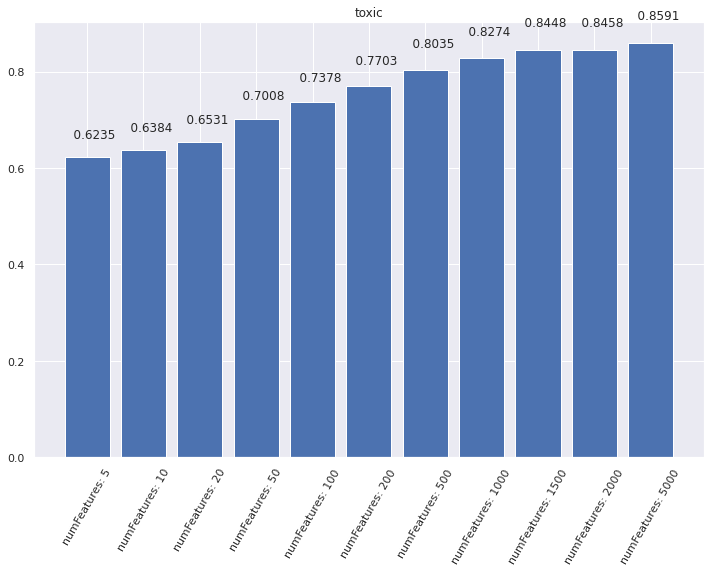

Most efficient numFeatures: 5000: 0.8591
Fitting toxic model spent   570.1662


In [22]:
eval_time = time.time()
toxic_model = tfidf_fit_cv("toxic")
eval_time = time.time() - eval_time

print_results(toxic_model, "toxic")
results["toxic_model"] = get_scores(toxic_model)
print("Fitting toxic model spent {:10.4f}".format(eval_time))

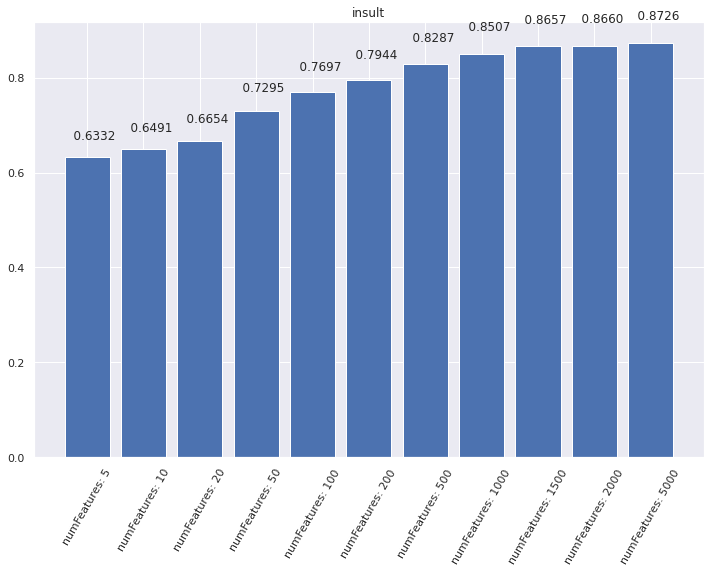

Most efficient numFeatures: 5000: 0.8726
Fitting insult model spent   588.1686


In [24]:
eval_time = time.time()
insult_model = tfidf_fit_cv("insult")
eval_time = time.time() - eval_time

print_results(insult_model, "insult")
results["insult_model"] = get_scores(insult_model)
print("Fitting insult model spent {:10.4f}".format(eval_time))

In [25]:
results

{'identity_hate_model': {'numFeatures: 5': 0.6103958587169676,
  'numFeatures: 10': 0.6132399066663685,
  'numFeatures: 20': 0.6397861735984552,
  'numFeatures: 50': 0.6737453848624141,
  'numFeatures: 100': 0.713650541182604,
  'numFeatures: 200': 0.7435314226838603,
  'numFeatures: 500': 0.7872704780227064,
  'numFeatures: 1000': 0.7992965679655386,
  'numFeatures: 1500': 0.80885877960294,
  'numFeatures: 2000': 0.814047659971889,
  'numFeatures: 5000': 0.8066324575560444},
 'obscene_model': {'numFeatures: 5': 0.6399918659586383,
  'numFeatures: 10': 0.6566508902872318,
  'numFeatures: 20': 0.6717678110979094,
  'numFeatures: 50': 0.7465485237521632,
  'numFeatures: 100': 0.7830722345406987,
  'numFeatures: 200': 0.8082143248414504,
  'numFeatures: 500': 0.8372735992725098,
  'numFeatures: 1000': 0.8565311947933789,
  'numFeatures: 1500': 0.870544918206297,
  'numFeatures: 2000': 0.8670481338375671,
  'numFeatures: 5000': 0.8669571171978141},
 'threat_model': {'numFeatures: 5': 0.617

# Блок 2. Word2Vec
1) Подготовить фичи комментариев с помощью w2v  
2) Обучить линейный классификатор и сравнить метрики качества с предыдущими подходами

In [11]:
results_w2v = {}
vector_size_grid = [10, 50, 100]

In [12]:
def w2v_fit_cv(target_col="toxic", df=lowered_df, vector_size_grid=vector_size_grid):
    
    tokenizing_stage = feature.Tokenizer(inputCol="lower_text", outputCol="tokenized_words")
    word_filterring_stage = feature.StopWordsRemover(inputCol="tokenized_words", outputCol="filtered_words")
    word_2_vec = feature.Word2Vec(vectorSize=10, minCount=0, inputCol="filtered_words", outputCol="features")
    indexing_stage = feature.StringIndexer(inputCol=target_col, outputCol="label")
    lr_stage = LogisticRegression(maxIter=10)

    preparing_pipeline = pyspark.ml.Pipeline(stages= [
        tokenizing_stage,
        word_filterring_stage,
        word_2_vec,
        indexing_stage,
        lr_stage
    ])

    param_grid = ParamGridBuilder().addGrid(
        word_2_vec.vectorSize, 
        vector_size_grid
    ).build()

    cv = CrossValidator(
        estimator=preparing_pipeline,
        estimatorParamMaps=param_grid, 
        evaluator=BinaryClassificationEvaluator(),
        #verbose=10,
        seed=7776
    )
    model = cv.fit(df)
  
    return model

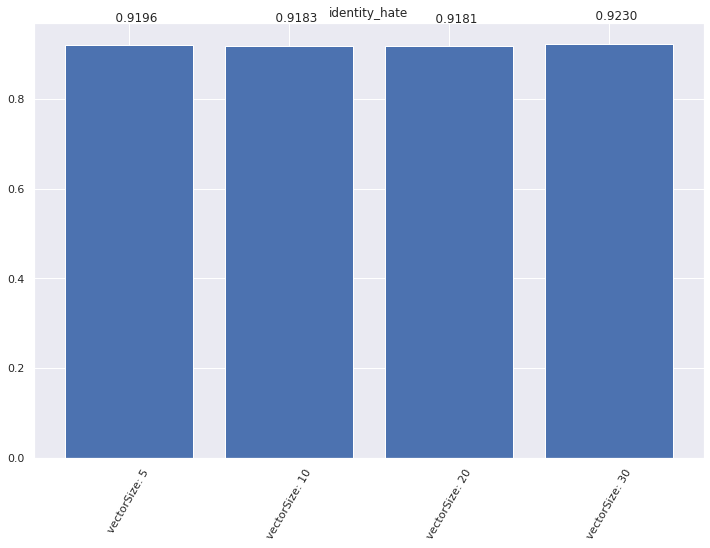

Most efficient vectorSize: 30: 0.9230
Fitting identity_hate model spent  1071.2996


In [19]:
eval_time = time.time()
identity_hate_model = w2v_fit_cv("identity_hate", vector_size_grid=[5, 10, 20, 30])
eval_time = time.time() - eval_time

print_results(identity_hate_model, "identity_hate")
results_w2v["identity_hate_model"] = get_scores(identity_hate_model)
print("Fitting identity_hate model spent {:10.4f}".format(eval_time))

Незадолго до отправки я затер выводы всего ноутбука, забыв, что он считается очень долго. В результате у уменьшил число проверяемых параметров для последующих запусков, чтобы как-то уложиться во времени(

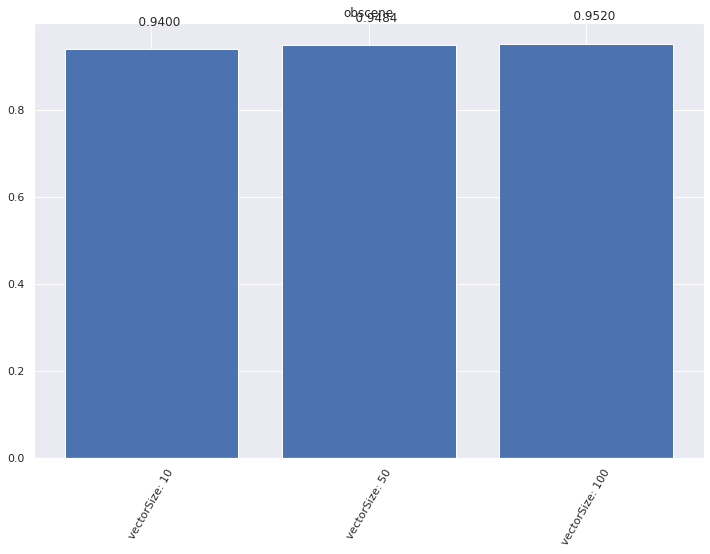

Most efficient vectorSize: 100: 0.9520
Fitting obscene model spent  1037.9840


In [26]:
eval_time = time.time()
obscene_model = w2v_fit_cv("obscene")
eval_time = time.time() - eval_time

print_results(obscene_model, "obscene")
results_w2v["obscene_model"] = get_scores(obscene_model)
print("Fitting obscene model spent {:10.4f}".format(eval_time))

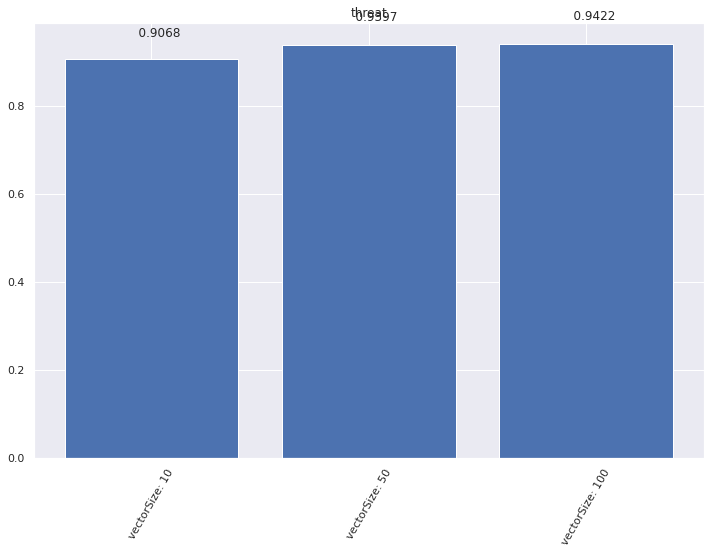

Most efficient vectorSize: 100: 0.9422
Fitting threat model spent  1027.7712


In [28]:
eval_time = time.time()
threat_model = w2v_fit_cv("threat")
eval_time = time.time() - eval_time

print_results(threat_model, "threat")
results_w2v["threat_model"] = get_scores(threat_model)
print("Fitting threat model spent {:10.4f}".format(eval_time))

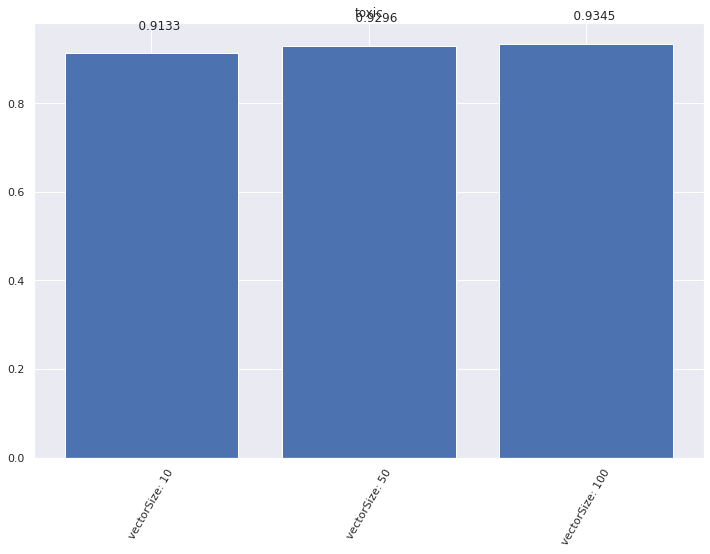

Most efficient vectorSize: 100: 0.9345
Fitting toxic model spent  1002.0339


In [13]:
eval_time = time.time()
toxic_model = w2v_fit_cv("toxic")
eval_time = time.time() - eval_time

print_results(toxic_model, "toxic")
results_w2v["toxic_model"] = get_scores(toxic_model)
print("Fitting toxic model spent {:10.4f}".format(eval_time))

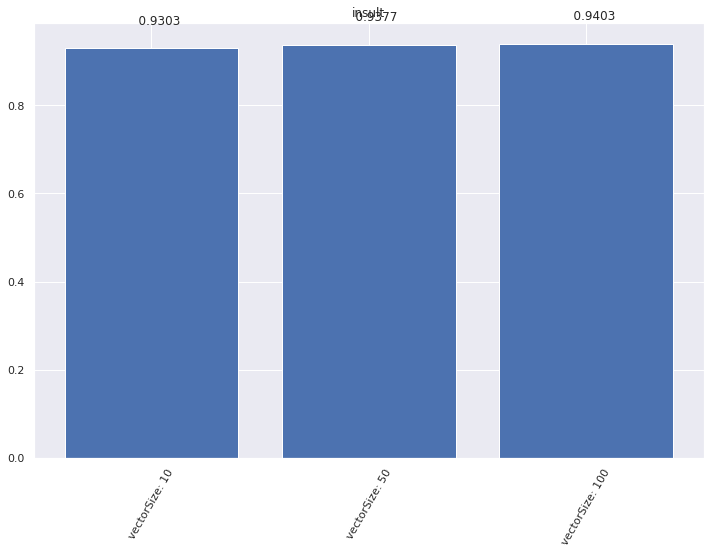

Most efficient vectorSize: 100: 0.9403
Fitting insult model spent  1013.6963


In [15]:
eval_time = time.time()
insult_model = w2v_fit_cv("insult")
eval_time = time.time() - eval_time

print_results(insult_model, "insult")
results_w2v["insult_model"] = get_scores(insult_model)
print("Fitting insult model spent {:10.4f}".format(eval_time))

target: identity_hate_model
  For target 'identity_hate_model' best score for w2v model got with option vectorSize: 30: 0.92304
  For target 'identity_hate_model' best score for tf-idf model got with option numFeatures: 2000: 0.81405

w2v with vectorSize: 30 is better (scores: 0.92304 > 0.81405)


/home/alex/anaconda3/envs/tf-gpu/lib/python3.6/site-packages/ipykernel_launcher.py:30: MatplotlibDeprecationWarning: Passing the minor parameter of set_ticks() positionally is deprecated since Matplotlib 3.2; the parameter will become keyword-only two minor releases later.
/home/alex/anaconda3/envs/tf-gpu/lib/python3.6/site-packages/ipykernel_launcher.py:31: UserWarning: FixedFormatter should only be used together with FixedLocator


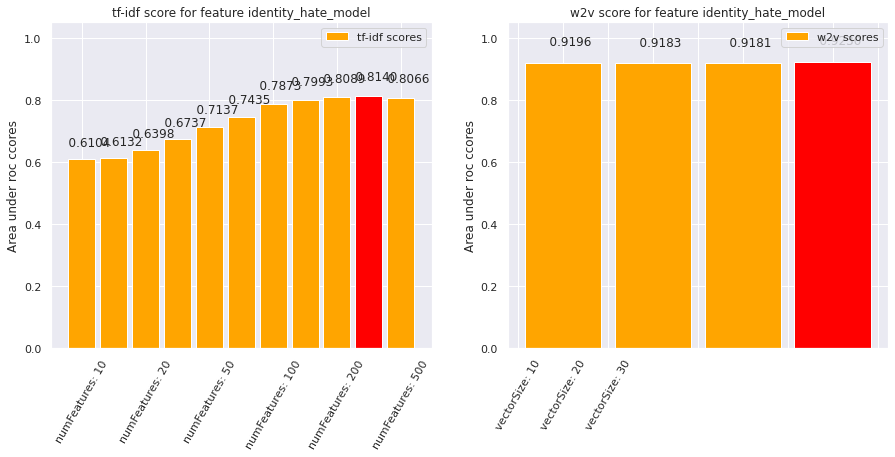



--------------------
target: obscene_model
  For target 'obscene_model' best score for w2v model got with option vectorSize: 100: 0.95201
  For target 'obscene_model' best score for tf-idf model got with option numFeatures: 1500: 0.87054

w2v with vectorSize: 100 is better (scores: 0.95201 > 0.87054)


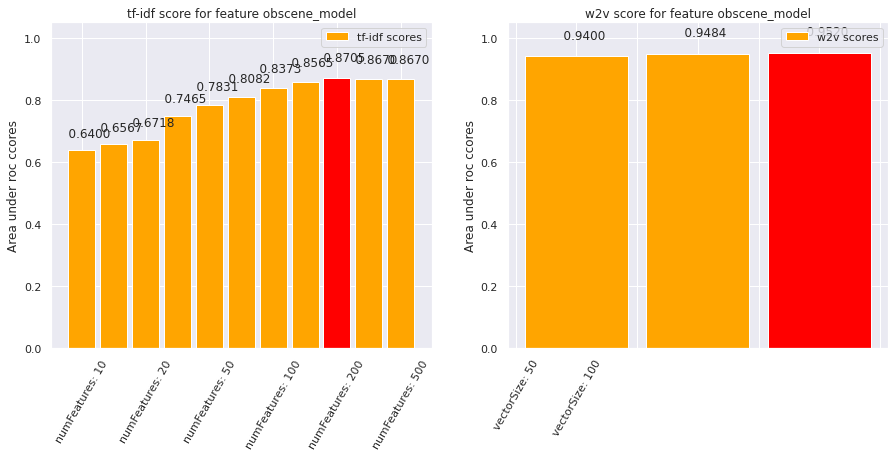



--------------------
target: threat_model
  For target 'threat_model' best score for w2v model got with option vectorSize: 100: 0.94220
  For target 'threat_model' best score for tf-idf model got with option numFeatures: 1500: 0.87547

w2v with vectorSize: 100 is better (scores: 0.94220 > 0.87547)


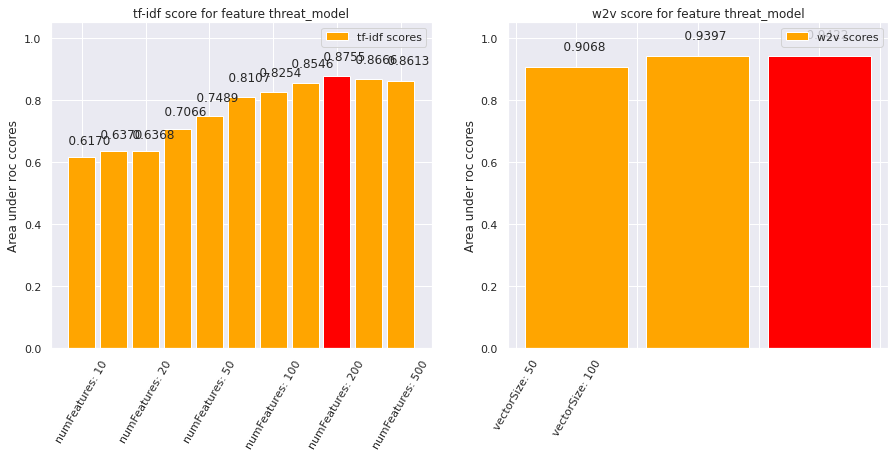



--------------------
target: toxic_model
  For target 'toxic_model' best score for w2v model got with option vectorSize: 100: 0.93451
  For target 'toxic_model' best score for tf-idf model got with option numFeatures: 5000: 0.85915

w2v with vectorSize: 100 is better (scores: 0.93451 > 0.85915)


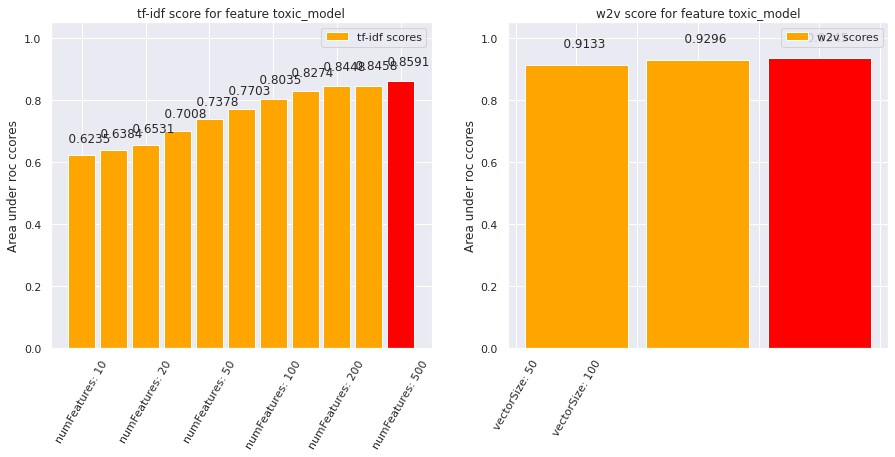



--------------------
target: insult_model
  For target 'insult_model' best score for w2v model got with option vectorSize: 100: 0.94030
  For target 'insult_model' best score for tf-idf model got with option numFeatures: 5000: 0.87259

w2v with vectorSize: 100 is better (scores: 0.94030 > 0.87259)


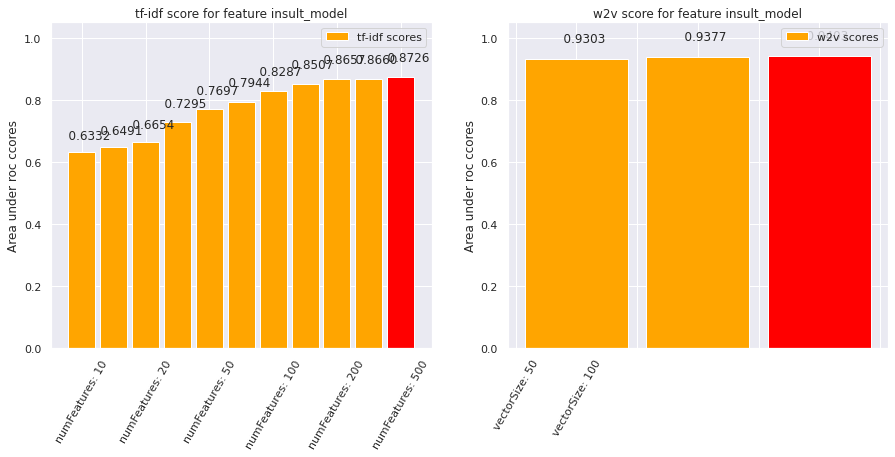



--------------------


In [26]:
best_models = {}

for target_name in results.keys():
    fig, [ax_tfidf, ax_w2v] = plt.subplots(1, 2, figsize=(15, 6))

    all_scores_dict = {"w2v": results_w2v[target_name], "tf-idf": results[target_name]}
    ax_dict = {"w2v": ax_w2v, "tf-idf": ax_tfidf}
    cur_best_opt = {}

    print("target: {}".format(target_name))
    for model_name in ["w2v", "tf-idf"]:
        scores_dict = all_scores_dict[model_name]
        ax = ax_dict[model_name]

        labels = list(scores_dict.keys())
        labels.sort(key=lambda x: int(x.split(" ")[-1]))
        scores = [scores_dict[num_features] for num_features in labels]
        x = np.arange(len(labels))

        colors = ['orange'] * len(scores)
        best_opt = np.argmax(scores)
        colors[best_opt] = 'red'

        bars = ax.bar(x, scores, color=colors, width=0.85, label="{} scores".format(model_name))
        ax.set_title('{} score for feature {}'.format(model_name, target_name))
        
        ax.set_ylabel('Area under roc ccores')
        ax.set_ylim(0, 1.05)
        
        ax.set_xticks(x, labels)
        ax.set_xticklabels(labels, rotation=60)
        set_barlabel(ax, bars, scores)
        ax.legend()
        print("  For target '{}' best score for {} model got with option {}: {:2.5f}".format(
            target_name, model_name, labels[best_opt], scores[best_opt]
        ))
        cur_best_opt[model_name] = {"option": labels[best_opt], "score": scores[best_opt]}
       
    best_model = "tf-idf"
    another_model = "w2v"
    if cur_best_opt["w2v"]["score"] > cur_best_opt["tf-idf"]["score"]:
        best_model = "w2v"
        another_model = "tf-idf"
        
    print("\n{} with {} is better (scores: {:2.5f} > {:2.5f})".format(
        best_model, cur_best_opt[best_model]["option"], cur_best_opt[best_model]["score"], cur_best_opt[another_model]["score"]
    ))
    best_models[target_name] = {
        "model_name": best_model, 
        "option": cur_best_opt[best_model]["option"], 
        "score": cur_best_opt[best_model]["score"]
    }
    
    plt.show()
    print("\n\n" + "-"*20)

In [27]:
for target_name, model_desr in best_models.items():
    print("For {} best model was {} (option: {}) with score: {:2.5f}".format(
        target_name, model_desr["model_name"], model_desr["option"], model_desr["score"]
    ))

For identity_hate_model best model was w2v (option: vectorSize: 30) with score: 0.92304
For obscene_model best model was w2v (option: vectorSize: 100) with score: 0.95201
For threat_model best model was w2v (option: vectorSize: 100) with score: 0.94220
For toxic_model best model was w2v (option: vectorSize: 100) with score: 0.93451
For insult_model best model was w2v (option: vectorSize: 100) with score: 0.94030


По результатам видно, что: 
- w2v стабильно лучше tf-idf  
- изменение гиперпараметров для w2v незначительно влияет на скор, в отличии от tf-idf, где подбор гиперпараметров может сильно изменить результат